# Data 601 Project: City of Medicine Hat Area Oil & Gas Production  
## Group Members:  
**Yuyao Chen UCID# 30108909<br>Bill Spackman UCID# 00239061<br>Gerwin Seier UCID# 30104289**

## Introduction  
The city of Medicine Hat, Alberta recently announced that they will be shutting in 2,000 active natural gas wells due to low gas prices . Our project group proposes an illustrative history of oil and gas production in the Medicine Hat area to provide context on this decision. 

## Guiding Quesions  
The overarching goal of this analysis is to provide visuals illustrating how oil and gas production, in the Medicine Hat area, have evolved over time. Time, in our context, is the last 20 years. Specific questions that we will address include:  

* Who are the operators in the area? How significant is the operator City of Medicine Hat in the context of total production?  
* How many wells are producing? Which operators are drilling them?    
* Where is the production coming from? Specifically: what are the producing geologic formations? And, how is the production distributed spatially?       
* How has the per well profitability changed over time?    
      
We expect the well drilling activity and production measures to vary both spatially and over time. These visuals will aid in identifying trends. We suspect those trends will add insight into the decision for the City of Medicine Hat to shut in their wells. 


In [1]:
# Package import and setup

import pandas as pd
import numpy as np
import datetime as dt
import geopandas as gpd
import plotly.graph_objects as go
import plotly.express as px
import ipywidgets as widgets
from ipywidgets import interact
import plotly.offline as py
from calendar import monthrange
from plotly.subplots import make_subplots
import seaborn as sns
import xlrd 
import warnings
warnings.filterwarnings("ignore") # hide warnings

py.init_notebook_mode(connected=True)
%matplotlib notebook
pd.options.display.float_format = '{:.3f}'.format

from IPython.display import HTML

# Toggle butten to hide the code from the notebook

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')


## Data Source
The dataset for this project consists of well information and production data associated to oil and gas wells. It was sourced from GeoScout; a databasing and mapping software program owned by GeoLogic Systems Inc. Public production and well data, collected by the Alberta Energy Regulator, is aggregated by Geologic Systems in the GeoScout platform. GeoScout is licensed to the University of Calgary for non-commercial use and was accessed via the University of Calgary Geosciences laboratory.   

The queried wells were within a 75 km radius of Medicine Hat. The data is shaped in two tables: one of well header data, and one of production data. Both tables were exported into .csv format.  
  


In addition, historical pricing data was downloaded from GLJ Petroleum Consultants (GLJ) website (https://www.gljpc.com/price-charts). This pricing data is publicly available from the website; and is free to use under the stipulation that GLJ does not guarantee accuracy. 
The pricing data is a .csv file which contains the monthly gas and oil price from 2009 to present. For our analysis, we will reference the Edmonton Light oil price and AECO gas price, in Canadian dollars.  


### Well Header Data
The well header .csv file features one well per row, with approximately 15,000 wells. Each well has 243 different attributes which include information such as: well name, latitude/longitude location, operator, drilling date, formation, and production summaries. 

In [2]:
# Read the header dataset
well_head_data = pd.read_csv('./well_header_data.csv', low_memory=False)
display(well_head_data.head())

,Sort Format Well ID (Long),Sort Format Well ID,CPA Pretty Well ID (Long),CPA Pretty Well ID,CPA Well ID (Long),CPA Well ID,Abbreviated Well ID,User-Format Well ID,Area,Well Status Abrv,...,On Inject. YYYY/MM/DD,First Inject. YYYY/MM,Last Inject. YYYY/MM,Cumulative GAS Inject. (e3m3),Cumulative WTR Inject. (m3),Cumulative Steam Inject. (m3),Total Production Hrs,First 12 mo. Hrs On,Last 12 mo. Hrs On,Most Recent 12 mo. Hrs On
0,0094033003S00,0094033003S00,1S0/03-30-009-03W4/00,1S0/03-30-009-03W4/00,1S0033000903W400,1S0033000903W400,S0/03-30-009-03W4/0,1S0/03-30-009-03W4/00,AB,D&A,...,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan
1,94033010000,94033010000,100/10-30-009-03W4/00,100/10-30-009-03W4/00,100103000903W400,100103000903W400,00/10-30-009-03W4/0,100/10-30-009-03W4/00,AB,AZN,...,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan
2,94033010002,94033010002,100/10-30-009-03W4/02,100/10-30-009-03W4/02,100103000903W402,100103000903W402,00/10-30-009-03W4/2,100/10-30-009-03W4/02,AB,AZN,...,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan
3,94033010003,94033010003,100/10-30-009-03W4/03,100/10-30-009-03W4/03,100103000903W403,100103000903W403,00/10-30-009-03W4/3,100/10-30-009-03W4/03,AB,SG,...,NaN,NaN,NaN,nan,nan,nan,83815.000,7618.000,576.000,0.000
4,94033010004,94033010004,100/10-30-009-03W4/04,100/10-30-009-03W4/04,100103000903W404,100103000903W404,00/10-30-009-03W4/4,100/10-30-009-03W4/04,AB,AZN,...,NaN,NaN,NaN,nan,nan,nan,nan,nan,nan,nan


#### Column Choices

The first 8 columns are redundant. We select 'CPA Pretty Well ID (Long)' as our identifier to be consistent with our production dataset. 
We'll also pick specific columns to work with in our analysis to reduce the size of the table to a workable size.
In general we are interested in well location, operator, drilling and onstream date, producing formation and total production volumes.

In [3]:
# There's 28 columns that we're actually interested in:

columns_to_keep = ['CPA Pretty Well ID (Long)',
                   'Well Status Text',
                   'Org Operator Name', 
                   'Cur Operator Name',
                   'Date Well Spudded',
                   'Date Rig Released',
                   'Reference (KB) Elev. (m)',
                   'MD (All Wells) (m)',
                   'TVD (m)',
                   'Formation@TD',
                   'Bot-Hole Latitude (NAD83)',
                   'Bot-Hole Longitude (NAD83)',
                   'Surf-Hole Latitude (NAD83)',
                   'Surf-Hole Longitude (NAD83)',
                   'Prod./Inject. Frmtn',
                   'Producing Pool Name',
                   'On Prod YYYY/MM/DD',
                   'First Prod YYYY/MM',
                   'Last Prod. YYYY/MM',
                   'Cumulative GAS Prod. (e3m3)',
                   'Cumulative OIL Prod. (m3)',
                   'Cumulative CND Prod. (m3)',
                   'Cumulative WTR Prod. (m3)',
                   'First 12 mo. Total GAS (e3m3)',
                   'First 12 mo. Total OIL (m3)',
                   'First 12 mo. Total CND (m3)',
                   'First 12 mo. Total WTR (m3)',
                   'First 12 mo. Hrs On',
                  ]

filtered_well_head = well_head_data[columns_to_keep]
#display(filtered_well_head.head())

#### Data Cleaning  

For many of our plots we wanted to focus on just the most recent 20 years of production. To do so we culled the dataset to just include recent wells and saved as a csv file for future use.

The producing formation is the geological interval contributing to production. The formation names in the well header table are not particularily useful in this context, as the production is often producing from more than one formation. To simlify, we extracted the unique formation names and then manually created a csv file that grouped each formation into a larger group, based on geological age.

The process was:
* Thin out the number of rows to the wells that have values for our chosen columns.  
* Convert the dates to datetime objects.  
* Filter data to the time interval in question, 1999 to present.
* Export data to .csv file to be utilized in other analysis.  
* Export unique formation list to .csv file for other analysis.

Subsiquently the file 'formations_list.csv' was edited manually to group the different formation names.

In [4]:
date_cols = ['On Prod YYYY/MM/DD', 'First Prod YYYY/MM', 'Last Prod. YYYY/MM']

# Drop the wells that have never produced. i.e. 'On Prod', 'First Prod' or 'Last Prod' is NaN
filtered_well_head = filtered_well_head.dropna(subset=date_cols) 

# Convert the dates to datetime objects
for i in date_cols:
    filtered_well_head[i] = pd.to_datetime(filtered_well_head[i])

#display(filtered_well_head[date_cols].head())
final_well_data = filtered_well_head[filtered_well_head['On Prod YYYY/MM/DD'] >= pd.Timestamp(year=1999, month=1, day=1)]

#final_well_data.to_csv(r'./final_well_data.csv') # Uncomment to create new file
#display(final_well_data.describe())

#Get list of Formations and export to .csv for manual analysis

unique_formations = pd.DataFrame(final_well_data['Prod./Inject. Frmtn'].unique())
# unique_formations.to_csv(r'./formations_list.csv') # Uncomment to create new file

### Production Data
The production .csv file contains rows with well identifiers and production measure combinations *(19 per well)*; the columns have the associated volume or rate by month. The overall file of approximately 13,000 wells, 19 rows per well, and 694 month columns for an approximate 800MB size. 

We will be culled the dataset to the last 20 years worth of prouction for use in some of our analysis.    

In [5]:
# Load in the production sheet and work with it

prod_data = pd.read_csv('./monthly_production.csv')
display(prod_data.head())

,Unique Well ID,Data Item,196112,196201,196202,196203,196204,196205,196206,196207,...,201810,201811,201812,201901,201902,201903,201904,201905,201906,201907
0,100/10-30-009-03W4/03,Monthly GAS ( e3m3 ),0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,100/10-30-009-03W4/03,Monthly OIL ( m3 ),0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,100/10-30-009-03W4/03,Monthly WTR ( m3 ),0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,100/10-30-009-03W4/03,Monthly CND ( m3 ),0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
4,100/10-30-009-03W4/03,Monthly BOE ( Bbl ),0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000


#### Column Choices  
With months and years in a concatenated form as columns, our first step is to drop the columns outside of our date range of interest *(again 1999 to present)*.  
That data is then exported to a .csv file for further analysis.

In [6]:
#We want to drop production data pre Jan 1999 and save as csv. 


drop_col = prod_data.columns.get_loc('199901')
prod_data.drop(prod_data.iloc[:, 2:drop_col], axis=1, inplace=True)
#display(prod_data.head())

# prod_data.to_csv(r'./culled_monthly_production.csv') # Uncomment to create new file

#### Data Cleaning  
To shape this data into a workable form, a few steps are undertaken.  
<ol>
<li>Stacking the date columns as rows.  </li>
  
<li>Dealing with zeros. There are a lot of zero production months. All months in the dataset have values regardless of if the well was drilled yet, is producing, or has been shut in. For example, few wells in this data set actually produce oil. With the utilization of cumulative production per month by well, zero values have no bearing. They will be removed from analysis.  </li>
  
<li>Both the Well Identifier and the date columns have to be parsed out.  
<ul> 
    <li> Well Identifier parsed into the Township and Range values (part of the Dominion Land Survey system representing 6 mile x 6 mile blocks of land)</li>
    <li> Date columns parsed into Month and Year components</li>
    </ul>
<li>Re-Index the data based on the new Township, Range, Year, and Month columns</li>
    <li>Unstack the different measures into columns</li>
</ol>  
    
    


In [7]:
prod_data = pd.read_csv('./culled_monthly_production.csv') # Uncomment if using different culled file
# Set two columns as index. Remove imported index counter column. Remaining columns are all date related.
prod_data.set_index(['Unique Well ID', 'Data Item'], inplace = True)
#display(prod_data.head())
prod_data.drop("Unnamed: 0", axis=1, inplace=True)

# Stack all the date columns into rows. Reset index to allow for parsing manipulation. New Dataframe.
prod_data_date = pd.DataFrame(prod_data.stack()).reset_index()
prod_data_date.rename(columns = {0:"Measures"}, inplace=True)

# Remove zero values. No use in this analysis.
prod_data_date = prod_data_date[prod_data_date['Measures'] != 0]
#display(prod_data_date.head(5))

# Parse out year and month based on position in string. Remove original column.
prod_data_date["Year"]=prod_data_date["level_2"].str[:4]
prod_data_date["Month"]=prod_data_date["level_2"].str[4:]
prod_data_date.drop("level_2", axis=1, inplace=True)

# Parse out township and range values from UWI based on position. All entries W4.
prod_data_date["Township"]=prod_data_date["Unique Well ID"].str[10:13]
prod_data_date["Range"]=prod_data_date["Unique Well ID"].str[14:16]

# Re-index dataframe based on grid bins and date. Unstack the different measures into columns
prod_data_date.set_index(['Township','Range','Unique Well ID','Year','Month', 'Data Item'], inplace = True)
#prod_data_date.rename(columns = {0:"Measures"}, inplace=True)
prod_data_date = prod_data_date.unstack('Data Item')
prod_data_date = prod_data_date.droplevel(0, axis = 1)

display(prod_data_date.head()) # this df is called for subsiquent visualizations

Data Item                                        Cal Dly Avg BOE ( Bbl )  \
Township Range Unique Well ID        Year Month                            
009      03    100/06-31-009-03W4/00 2004 03                       1.200   
                                          04                       5.400   
                                          05                       9.700   
                                          06                      10.200   
                                          07                       7.700   

Data Item                                        Cal Dly Avg FLD ( m3 )  \
Township Range Unique Well ID        Year Month                           
009      03    100/06-31-009-03W4/00 2004 03                      0.300   
                                          04                      0.200   
                                          05                      0.300   
                                          06                      0.300   
                                          07                      0.200   

Data Item                                        Cal Dly Avg GAS ( e3m3 )  \
Township Range Unique Well ID        Year Month                             
009      03    100/06-31-009-03W4/00 2004 03                        0.200   
                                          04                        0.900   
                                          05                        1.700   
                                          06                        1.700   
                                          07                        1.300   

Data Item                                        Cal Dly Avg OIL ( m3 )  \
Township Range Unique Well ID        Year Month                           
009      03    100/06-31-009-03W4/00 2004 03                        nan   
                                          04                        nan   
                                          05                        nan   
                                          06                        nan   
                                          07                        nan   

Data Item                                        Cal Dly Avg WTR ( m3 )  \
Township Range Unique Well ID        Year Month                           
009      03    100/06-31-009-03W4/00 2004 03                      0.300   
                                          04                      0.200   
                                          05                      0.300   
                                          06                      0.300   
                                          07                      0.200   

Data Item                                        Monthly BOE ( Bbl )  \
Township Range Unique Well ID        Year Month                        
009      03    100/06-31-009-03W4/00 2004 03                  37.700   
                                          04                 160.700   
                                          05                 301.400   
                                          06                 307.200   
                                          07                 238.400   

Data Item                                        Monthly FLD ( m3 )  \
Township Range Unique Well ID        Year Month                       
009      03    100/06-31-009-03W4/00 2004 03                  8.200   
                                          04                  5.700   
                                          05                 10.400   
                                          06                  9.500   
                                          07                  7.400   

Data Item                                        Monthly GAS ( e3m3 )  \
Township Range Unique Well ID        Year Month                         
009      03    100/06-31-009-03W4/00 2004 03                    6.400   
                                          04                   27.300   
                                          05          

#### Measure Choices  
With the data in this shape, we can now choose the columns corresponding to the measures of interest. Only Monthly Gas and Monthly Oil will be retained.

In [8]:
#display(list(prod_data_date.columns.values))
# Measures to compare are monthly gas and oil production. Drop other columns
measuresKeep = [('Monthly GAS ( e3m3 )'),  ('Monthly OIL ( m3 )')]
filtered_prod_data = prod_data_date[measuresKeep]
display(filtered_prod_data.head())

Data Item                                        Monthly GAS ( e3m3 )  \
Township Range Unique Well ID        Year Month                         
009      03    100/06-31-009-03W4/00 2004 03                    6.400   
                                          04                   27.300   
                                          05                   51.200   
                                          06                   52.200   
                                          07                   40.500   

Data Item                                        Monthly OIL ( m3 )  
Township Range Unique Well ID        Year Month                      
009      03    100/06-31-009-03W4/00 2004 03                    nan  
                                          04                    nan  
                                          05                    nan  
                                          06                    nan  
                                          07                    nan

## Data Exploration

We used seaborn to visually inspect the data.

This visualization merges the well header with the formation groupings so that we can compare data pairs by formation. 

The primary purpose of this analysis was simple to explore what data is available for use.

In [9]:
# Read in the well header csv file and manipulate

well_head_data = pd.read_csv('./well_header_data.csv', low_memory=False)
columns_to_keep = ['CPA Pretty Well ID (Long)', 'Cur Operator Name','On Prod YYYY/MM/DD', 'Prod./Inject. Frmtn','Cumulative GAS Prod. (e3m3)',
 'Cumulative OIL Prod. (m3)',]
box_data = well_head_data[columns_to_keep]
box_data.dropna(inplace=True)
box_data['Year'] = pd.to_datetime(box_data['On Prod YYYY/MM/DD']).dt.year
box_data['Month'] = pd.to_datetime(box_data['On Prod YYYY/MM/DD']).dt.month
box_data['Cumulative Gas Prod (m3)'] = box_data['Cumulative GAS Prod. (e3m3)']/1000
box_data['Total Production'] = box_data['Cumulative OIL Prod. (m3)'] + box_data['Cumulative Gas Prod (m3)']
box_data.head(5)
#caculate yearly production
box_data_year = box_data.groupby(['Year']).sum()
box_data_year.reset_index(inplace=True)

box_data_year = box_data_year.drop(['Month','Cumulative GAS Prod. (e3m3)'],axis=1)
# box_data_year.head(3)

In [10]:
# Continue Modifications to the well header data.

well_data = pd.merge(how='left', left=box_data, right=box_data_year, 
                     left_on='Year', right_on='Year')
well_data_edit= well_data.rename(columns = {"Cumulative OIL Prod. (m3)_x": "Bywell_cumulative Oil Prod(m3)",
                                       "Cumulative Gas Prod (m3)_x":"Bywell_cumulative Gas Prod(m3)",
                                       "Total Production_x":"Bywell_cumulative total Prod(m3)",
                                       "Cumulative OIL Prod. (m3)_y":"Yearly Oil cumulative total Prod(m3)",
                                       "Cumulative Gas Prod (m3)_y":"Yearly Gas cumulative total Prod(m3)",
                                       "Total Production_y":"Yearly Total cumulative total Prod(m3)"}                       
                           
                           ) 
well_data_edit1 = well_data_edit.drop(['Cumulative GAS Prod. (e3m3)','On Prod YYYY/MM/DD'],
                                axis=1)
well_data_edit2 = well_data_edit1.groupby(['Year','Month'])['CPA Pretty Well ID (Long)'].count()
well_data = pd.merge(how='left', left=well_data_edit1, right=well_data_edit2, 
                     left_on=['Year','Month'], right_on=['Year','Month'])
well_data= well_data.rename(columns = {"CPA Pretty Well ID (Long)_y": "Well_counts"}) 
# well_data.head(2)

In [11]:
# Merge the well header data with the formations list so that the data can be grouped by formation

formations_list = pd.read_csv('./formations_list.csv')
formations_list.head()
well_data_final = pd.merge(how='left', left=well_data, right=formations_list, 
                     left_on='Prod./Inject. Frmtn', right_on='prod_form')
# well_data_final = well_data_final.drop(['Prod./Inject. Frmtn','prod_form'],axis=1)
well_data_final2 = well_data_final.drop(['CPA Pretty Well ID (Long)_x', 'Prod./Inject. Frmtn','prod_form'], axis=1)
well_data_final2 = well_data_final2.dropna()
well_data_explore = well_data_final2.drop(['Cur Operator Name',
                                           'Yearly Oil cumulative total Prod(m3)',
                                           'Yearly Gas cumulative total Prod(m3)'], axis=1)
# well_data_final2.head(2)

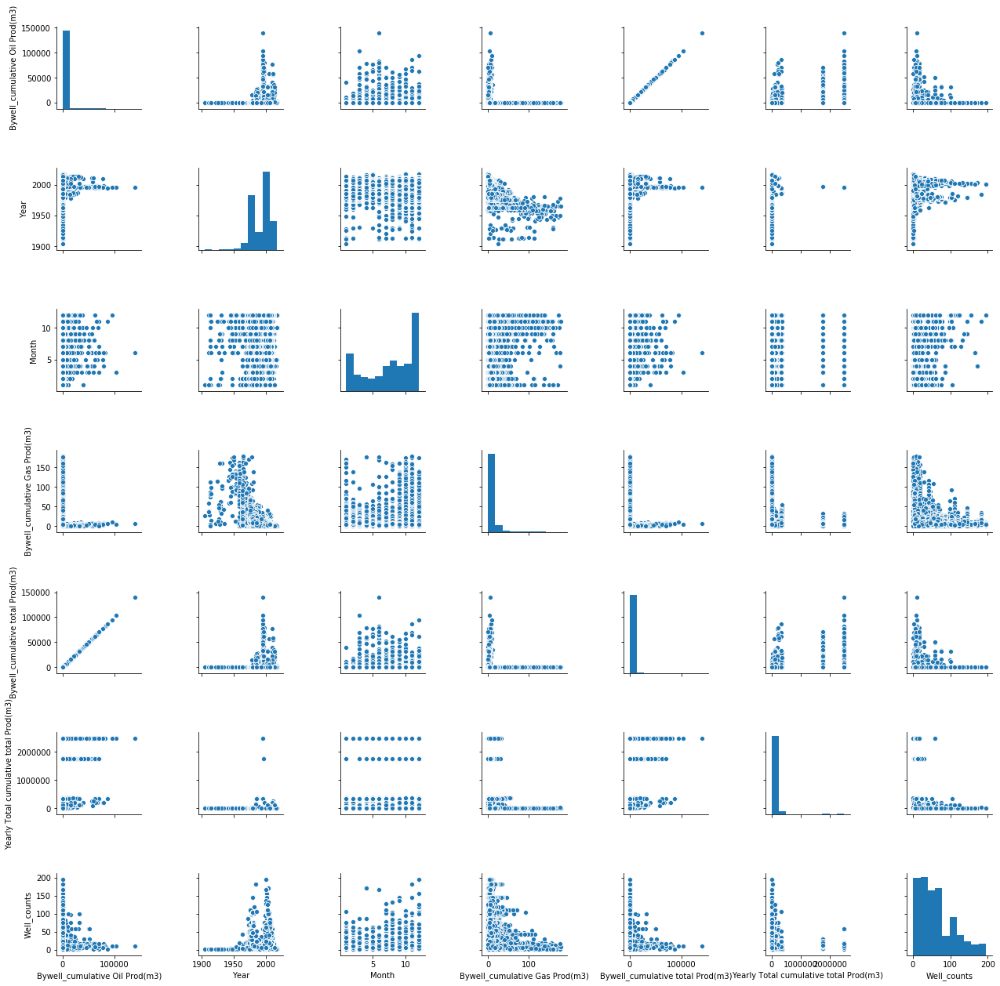

In [12]:
sns.pairplot(data = well_data_explore )

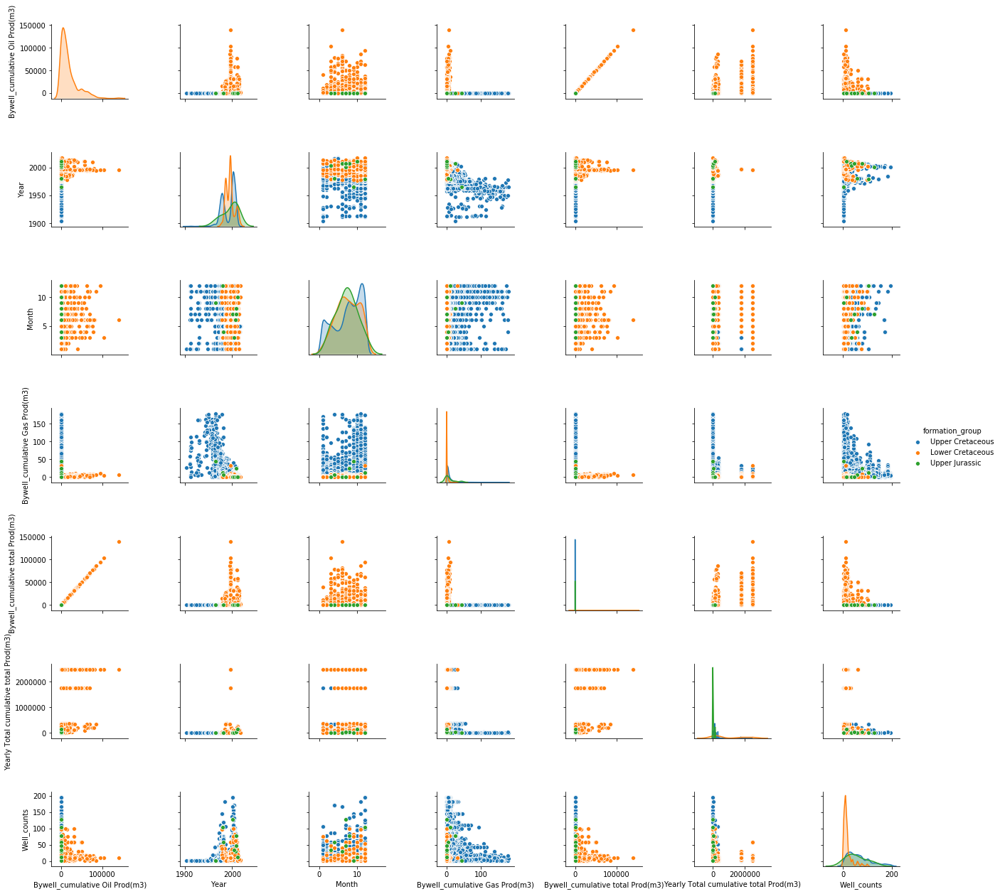

In [13]:
sns.pairplot(data = well_data_explore, hue = 'formation_group')

## New Wells Drilled variation with Gas Price  
Does the market price of gas impact the number of wells drilled?

One of the reasons that the City of Medicine Hat might be shutting in production is that the price of gas has been pervasively low. 

A useful insight would be, how many wells have been drilled recently, compared to the natural gas price.

We realized that the GLJ natural gas price data [2] did not extend prior to 2009. We therefore found historical NYMEX Gas prices, that could be used for this visualization [3]. 

In [14]:

# Pull in the price data; re-use the well_data df from the prior visalization

price_data = pd.read_excel(r'./Gas_price_and_wells_drilled.xlsx')

price_data.rename(columns={'Unnamed: 1':'year', 'Unnamed: 2': 'month', 
                           'https://www.macrotrends.net/2478/natural-gas-prices-historical-chart':'Gas Price'}, inplace=True)
price_data = price_data.drop(['date'],
                             axis=1)
well_data_final2 = pd.merge(how='left', left=well_data, right=price_data, 
                     left_on=['Year','Month'], right_on=['year','month'])
well_data_final2 = well_data_final2.drop(['year','month'], axis=1)
well_data_final3 = well_data_final2.drop_duplicates()

well_price = well_data_final3.dropna()
well_data_sort1 = well_price.sort_values('Year',ascending=True)
well_data_sort1.head(5)
well_data_sort1['Date'] = pd.to_datetime(well_data_sort1[['Year', 'Month']].assign(Day=1)).dt.strftime('%Y-%m')
well_data_sort1= well_data_sort1.drop(['Year','Month'], axis=1)
well_data_sort1 = well_data_sort1.drop_duplicates()
well_data_sort1['Well_counts(by 10)'] = well_data_sort1['Well_counts']/10
well_data_sort1 = well_data_sort1.sort_values('Date')
well_data_sort1.head(2)

,CPA Pretty Well ID (Long)_x,Cur Operator Name,Prod./Inject. Frmtn,Bywell_cumulative Oil Prod(m3),Bywell_cumulative Gas Prod(m3),Bywell_cumulative total Prod(m3),Yearly Oil cumulative total Prod(m3),Yearly Gas cumulative total Prod(m3),Yearly Total cumulative total Prod(m3),Well_counts,value,Gas Price,Wells Drilled,Date,Well_counts(by 10)
7215,102/06-24-014-07W4/00,City of Medicine Hat,Kmed_hat,0.000,3.531,3.531,1761062.000,782.896,1761844.896,16,5.260,3.260,0.000,1997-01,1.600
7087,102/14-16-014-07W4/00,IPC Cda Ltd,Kmed_hat,0.000,3.743,3.743,1761062.000,782.896,1761844.896,16,5.260,3.260,0.000,1997-01,1.600


In [15]:


fig= make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(go.Scatter(x=well_data_sort1['Date'],
                         y=well_data_sort1['Well_counts(by 10)'],name = 'Well counts/10', line=go.scatter.Line(color='#17BECF')), 
                         secondary_y=False,
               )

   
fig.add_trace(go.Scatter(x=well_data_sort1['Date'],
                         y=well_data_sort1['Gas Price'],name = 'Gas price',line=go.scatter.Line(color='#7F7F7F')), 
                         secondary_y=True,
               )

fig.update_layout(
    title_text="Well counts and Gas Price for City of Med Hat Wells"
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="Well Counts", secondary_y=False)
fig.update_yaxes(title_text="Gas Price ($/mmbtu)", secondary_y=True) 

# Add range slider
fig.update_layout(
    xaxis=go.layout.XAxis(
        rangeselector=dict(
            buttons=list([
                
                dict(count=10,
                     label="10y",
                     step="year",
                     stepmode="backward"),
                 dict(count=20,
                     label="20y",
                     step="year",
                     stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

fig.show()

It looks like there has been very little drilling since approximately 2012, dispite the fact that prices have rebounded somewhat. There may be other factors than price at play, however there is certainly a lack of new investment in drilling wells in the area.

### Where are our wells? A map of gas wells colored by Operator 


Next we wanted to see what the wells looked like spatially. i.e. Where are the City of Medicine Hat wells actually located?

We also can add some quick reference fields, such as formation and cumulative gas production, as hover interactions to the map.

In [16]:
# Get Mapbox token https://www.mapbox.com/
try:
    file = open('./mapbox.token', 'r')
    for line in file:
        token = line.rstrip() # Use rstrip to get EOL-free lines
    file.close()
except FileNotFoundError as fnfe:
    print(fnfe)

In [17]:
# Read the header dataset
well_head_data = pd.read_csv('./well_header_data.csv', low_memory=False)
columns_to_keep = [ 'CPA Pretty Well ID (Long)', 
                   'Bot-Hole Latitude (NAD83)', 
                   'Bot-Hole Longitude (NAD83)',
                   'Bot-Hole Easting (NAD83)',
                   'Bot-Hole Northing (NAD83)',
                   'Cur Operator Name',
                   'On Prod YYYY/MM/DD',
                   'Prod./Inject. Frmtn',
                   'Cumulative GAS Prod. (e3m3)' ]
map_data = well_head_data[columns_to_keep].sort_values(by='Cur Operator Name')

# Convert lat/long to proper format
map_data['Bot-Hole Latitude (NAD83)'] = map_data['Bot-Hole Latitude (NAD83)'].apply(lambda x: float(x[:-1]))
map_data['Bot-Hole Longitude (NAD83)'] = map_data['Bot-Hole Longitude (NAD83)'].apply(lambda x: float(x[:-1])*-1)

# Bin cumulative Gas Production
map_data['Cumulative GAS Prod. (e3m3)'].fillna(0, inplace=True)
# bin_names = [x for x in range(1,17,5)]
bin_names = np.linspace(5,10,4)
bins = [map_data['Cumulative GAS Prod. (e3m3)'].quantile(x) for x in [0, 0.25, 0.5, 0.75, 1]]
bins[4] = bins[4] + 1 # so that max value is inclusive
map_data['Size'] = pd.cut(map_data['Cumulative GAS Prod. (e3m3)'], bins, right=False, labels = bin_names) 

px.set_mapbox_access_token(token)
fig2 = px.scatter_mapbox(map_data, lat='Bot-Hole Latitude (NAD83)', lon="Bot-Hole Longitude (NAD83)", 
                        color='Cur Operator Name',
                        color_discrete_map={'City of Medicine Hat':'#e31a1c'}, # City of Med Hat will be red
                        color_discrete_sequence=['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#fdbf6f','#ff7f00','#cab2d6','#6a3d9a','#ffff99','#b15928'],
                        title='Gas Wells by Operator', 
                        hover_name = 'CPA Pretty Well ID (Long)',
                        hover_data = ['On Prod YYYY/MM/DD', 'Prod./Inject. Frmtn','Cumulative GAS Prod. (e3m3)']
                       )

# fig2.show()


In [18]:
fig2.show()

### How many active wells does the City of Medicine Hat own?  
Number of wells drilled by each operator.

From the map it looks like there a lot of wells. How many does the city of Medicine hat actually own, and how many of them are 'active?' Active can mean different things, but for our purposes we defined active as having produced gas in 2019.

The following visualization show how many active and total wells, each operator has, within the study area.

In [19]:
# Add chart of number of wells by operator at current time

columns_to_keep = ['CPA Pretty Well ID (Long)', 
                   'Cur Operator Name',
                   'Last Prod. YYYY/MM']
num_wells = pd.read_csv('./well_header_data.csv', low_memory=False)[columns_to_keep]
num_wells['Last Prod. YYYY/MM'] = pd.to_datetime(num_wells['Last Prod. YYYY/MM'], errors='ignore')
num_wells.dropna(inplace=True)

#anything that produced since 2019 call 'active'
operator_wells = num_wells[num_wells['Last Prod. YYYY/MM'] >= dt.date(2019,1,1)] 
operator_wells['Active Wells'] = 1 
operator_wells.set_index('Cur Operator Name', inplace=True)
operator_wells = operator_wells.groupby(level=0).count()
operator_wells.reset_index(inplace=True)
operator_wells.drop(columns=['CPA Pretty Well ID (Long)','Last Prod. YYYY/MM'], inplace=True)

# Get total well count
num_wells['All Wells'] = 1 
num_wells.set_index('Cur Operator Name', inplace=True)
num_wells = num_wells.groupby(level=0).count()
num_wells.reset_index(inplace=True)
num_wells.drop(columns=['CPA Pretty Well ID (Long)','Last Prod. YYYY/MM'], inplace=True)
operator_wells = pd.merge(left=operator_wells, right=num_wells, how='left', on='Cur Operator Name')
operator_wells.sort_values(by=['All Wells'], ascending=False, inplace=True )

In [20]:
operator=operator_wells['Cur Operator Name']

fig3 = go.Figure(data=[
    go.Bar(name='Active', x=operator, y=operator_wells['Active Wells']),
    go.Bar(name='Total', x=operator, y=operator_wells['All Wells'])
])
# Change the bar mode
fig3.update_layout(barmode='group',title_text='Number of Active Wells by Operator (2019)')
fig3.show()

### Categories of data. Pie charts by producing formation and operator.

Having seen the well count by operator, we were also interested in the total gas production by operator and which formations were contributing the most gas.

In [21]:
# Plot production by formation and operator

formations_list = pd.read_csv('./formations_list.csv')
formations_list.head()
well_data_final = pd.merge(how='left', left=well_data, right=formations_list, 
                     left_on='Prod./Inject. Frmtn', right_on='prod_form')
# well_data_final = well_data_final.drop(['Prod./Inject. Frmtn','prod_form'],axis=1)
well_data_final2 = well_data_final.drop(['CPA Pretty Well ID (Long)_x', 'Prod./Inject. Frmtn','prod_form'], axis=1)
well_data_final2 = well_data_final2.dropna()
well_data_explore = well_data_final2.drop(['Cur Operator Name',
                                           'Yearly Oil cumulative total Prod(m3)',
                                           'Yearly Gas cumulative total Prod(m3)'], axis=1)

specs = [[{'type':'domain'}, {'type':'domain'}]]
figD = make_subplots(rows=1, cols=2, specs=specs)
figD.add_trace(go.Pie(labels=well_data_final2['formation_group'].values.tolist(), 
                     values=well_data_final2['Yearly Total cumulative total Prod(m3)'].values.tolist(),  textinfo='none'), 
              1,1)
figD.add_trace(go.Pie(labels=well_data_final2['Cur Operator Name'].values.tolist(), 
                     values=well_data_final2['Yearly Total cumulative total Prod(m3)'].values.tolist()
                    ,  textinfo='none'),1,2)
figD.update_traces(hole=.4, hoverinfo="label+percent+name")
# Format layout of chart
figD.update_layout(title_text="Total Oil and Gas Production by Operator and Formation",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Total production by formation', x=0.05, y= 0, font_size=15, showarrow=False),
                 dict(text='Total production by operator', x=0.95, y=0, font_size=15, showarrow=False)])

figD.show()

## Data Validation

Before we dig in too far on the production data, we wanted to see if there were any anomolies and determine if any data points may have been recorded in erro (as can happen in oil and gas data). Evaluate and remove from analysis if necessary.

Various box-plots were created to visualize the dataset. They are all included below for completeness:

### Boxplots of production header data

In [22]:
# Read the header dataset
well_head_data = pd.read_csv('./well_header_data.csv', low_memory=False)
columns_to_keep = ['CPA Pretty Well ID (Long)', 'On Prod YYYY/MM/DD', 
                   'Prod./Inject. Frmtn','Cumulative GAS Prod. (e3m3)']
box_data = well_head_data[columns_to_keep]
box_data.dropna(inplace=True)
box_data['Year'] = pd.to_datetime(box_data['On Prod YYYY/MM/DD']).dt.year
box_data['Month'] = pd.to_datetime(box_data['On Prod YYYY/MM/DD']).dt.month

fig4 = px.box(box_data, y='Cumulative GAS Prod. (e3m3)', title = "Cumulative Gas production")
fig4.update_yaxes(type="log")
fig4.show()

In [23]:
fig5 = px.box(box_data, y='Cumulative GAS Prod. (e3m3)', x="Year", title = "Cumulative Gas production by Year")
fig5.show()

From the above plot, it looks like there is someting strange in 1914. On further inspection there is one single well that produced over 4MM e3m3 of gas. 

In [24]:
# Create a box plot for each year. Select 1914 as the initial selection
box_data[box_data['Year'] == 1914]
min_year = min(box_data['Year'])
max_year = max(box_data['Year'])

In [25]:
# boxplot with dropdown to select year
box = go.Box()
fig_box = go.FigureWidget(data=box)
# A list passed to interact() will yield a drop-down interactor
@interact(year=[*range(max_year,min_year,-1)])
def update_box(year=1914):
    data = box_data[box_data['Year'] == year]
    fig_box.update_traces(x=data['Cumulative GAS Prod. (e3m3)'].values, name=str(year) + ' Cumulative Gas')
#     fig_box.update_name(year)
    fig_box.update_layout(title_text="Cumulative Gas produced for wells drilled in {0}".format(year), 
                          xaxis_title='Cumulative Gas Prod. (e3m3)')
fig_box

interactive(children=(Dropdown(description='year', index=104, options=(2018, 2017, 2016, 2015, 2014, 2013, 201…

FigureWidget({
    'data': [{'name': '1914 Cumulative Gas',
              'type': 'box',
              'uid': …

### Boxplots of Yearly production

In [26]:
fig5 = go.Figure()
# fig = ff.create_box(well_data_final2, height_constant=60)
# Make traces for graph
GasProduction = go.Box(x=well_data_final2['Year'].values.tolist(), 
                     y=well_data_final2['Bywell_cumulative Gas Prod(m3)'].values.tolist(), name='Cumulative Gas Production')

Oilproduction = go.Box(x=well_data_final2['Year'].values.tolist(), 
                     y=well_data_final2['Bywell_cumulative Oil Prod(m3)'].values.tolist(),name='Cumulative Oil Production',xaxis='x2', yaxis='y2')

# Add trace data to figure
fig5 = fig5.add_traces([GasProduction, Oilproduction])

# initialize xaxis2 and yaxis2
fig5['layout']['xaxis2'] = {}
fig5['layout']['yaxis2'] = {}

# Edit layout for subplots
fig5.layout.yaxis1.update({'domain': [0, .45]})
fig5.layout.yaxis2.update({'domain': [.5, 1]})

# The graph's yaxis2 MUST BE anchored to the graph's xaxis2 and vice versa
fig5.layout.yaxis2.update({'anchor': 'x2'})
fig5.layout.xaxis1.update({'anchor': 'y1'})
fig5.layout.yaxis1.update({'title': 'Gas Production(m3)'})
fig5.layout.yaxis2.update({'title': 'Oil Production(m3)'})

# Update the margins to add a title and see graph x-labels.
fig5.layout.margin.update({'t':75, 'l':50})
fig5.layout.update({'title': 'Cumulative production by Year'})

# Update the height because adding a graph vertically will interact with
# the plot height calculated for the table
fig5.layout.update({'height':800})

# fig5.show()

Layout({
    'height': 800,
    'margin': {'l': 50, 't': 75},
    'template': '...',
    'title': {'text': 'Cumulative production by Year'},
    'xaxis': {'anchor': 'y'},
    'yaxis': {'domain': [0, 0.45], 'title': {'text': 'Gas Production(m3)'}},
    'yaxis2': {'anchor': 'x2', 'domain': [0.5, 1], 'title': {'text': 'Oil Production(m3)'}}
})

In [27]:
fig5.show()

The production rates don't appear to have any more variability than we would expect from our experience with oil and gas data.

### Boxplots by formation

In [28]:
fig6 = go.Figure()

GasProduction = go.Box(x=well_data_final2['formation_group'].values.tolist(), 
                     y=well_data_final2['Bywell_cumulative Gas Prod(m3)'].values.tolist(), name='Cumulative Gas Production')

Oilproduction = go.Box(x=well_data_final2['formation_group'].values.tolist(), 
                     y=well_data_final2['Bywell_cumulative Oil Prod(m3)'].values.tolist(),name='Cumulative Oil Production',xaxis='x2', yaxis='y2')

# Add trace data to figure
fig6 = fig6.add_traces([GasProduction, Oilproduction])

# initialize xaxis2 and yaxis2
fig6['layout']['xaxis2'] = {}
fig6['layout']['yaxis2'] = {}

# Edit layout for subplots
fig6.layout.yaxis1.update({'domain': [0, .45]})
fig6.layout.yaxis2.update({'domain': [.5, 1]})

# The graph's yaxis2 MUST BE anchored to the graph's xaxis2 and vice versa
fig6.layout.yaxis2.update({'anchor': 'x2'})
fig6.layout.xaxis1.update({'anchor': 'y1'})
fig6.layout.yaxis1.update({'title': 'Gas Production(m3)'})
fig6.layout.yaxis2.update({'title': 'Oil Production(m3)'})

# Update the margins to add a title and see graph x-labels.
fig6.layout.margin.update({'t':75, 'l':50})
fig6.layout.update({'title': 'Cumulative production by Formation'})

# Update the height because adding a graph vertically will interact with
# the plot height calculated for the table
fig6.layout.update({'height':800})

# fig.show()

Layout({
    'height': 800,
    'margin': {'l': 50, 't': 75},
    'template': '...',
    'title': {'text': 'Cumulative production by Formation'},
    'xaxis': {'anchor': 'y'},
    'yaxis': {'domain': [0, 0.45], 'title': {'text': 'Gas Production(m3)'}},
    'yaxis2': {'anchor': 'x2', 'domain': [0.5, 1], 'title': {'text': 'Oil Production(m3)'}}
})

In [29]:
fig6.show()

All of the oil production is coming form the Lower Cretaceous whereas gas is from the Upper Cretaceous and Upper Jurassic.

### Data description and Box Plots of Production Data

In [30]:
display(filtered_prod_data.describe())

Data Item,Monthly GAS ( e3m3 ),Monthly OIL ( m3 )
count,2022737.000,34534.000
mean,23.652,139.162
std,27.359,154.392
min,0.100,0.100
25%,8.300,41.500
50%,16.000,85.800
75%,29.500,184.400
max,1574.100,1697.900


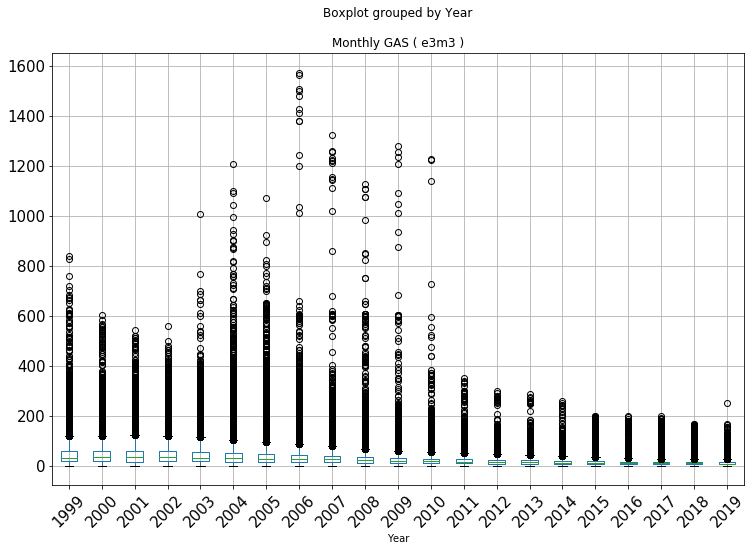

In [31]:
prodBox = filtered_prod_data.reset_index()
prodBox.boxplot(column='Monthly GAS ( e3m3 )', by='Year', rot=45, fontsize=15, figsize=(12,8))

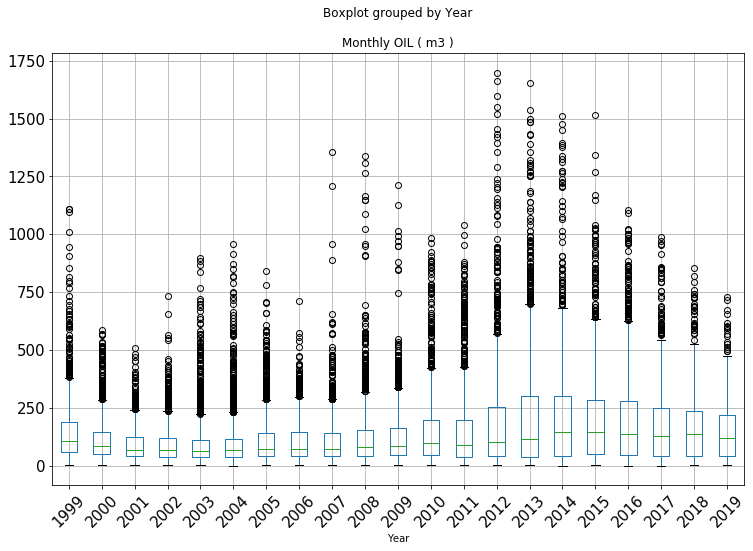

In [32]:
prodBox.boxplot(column='Monthly OIL ( m3 )', by='Year', rot=45, fontsize=15, figsize=(12,8))

## Production History Charts  
How has well production from our dataset varied over time?

Classic visualizations of oil and gas production data are Rate vs Time plots. Rate in this context is the rate of gas, oil and/or water production. We created an interactive plot to show the production rate of these three fluids vs time below.

In [33]:
# Read csv dataset + some formatting
prod_data = pd.read_csv('./monthly_production.csv')
prod_data.drop(columns='196112', inplace=True) # Don't want this date
prod_data.rename(columns={'Unique Well ID':'Well','Data Item':'Fluid'}, inplace=True)

# Only keep Oil/Gas/Wtr rates
data_to_keep = ['Cal Dly Avg GAS ( e3m3 )',
                'Cal Dly Avg OIL ( m3 )',
                'Cal Dly Avg WTR ( m3 )',]

prod_data = prod_data[prod_data.Fluid.isin(data_to_keep)]

def to_month(i): # converts column to datetime, if in the correct format
    try:
        return pd.to_datetime(i, format='%Y%m')
    except:
        return i
prod_data.rename(to_month, axis='columns', inplace=True)

# Set index for grouping
prod_data.set_index(['Well', 'Fluid'], inplace=True)
prod_data = prod_data.stack()
prod_data.index.rename("Date", level=2, inplace = True)

# total production for plotting
total_prod = prod_data.groupby(['Fluid','Date']).sum().unstack('Fluid')
total_prod.reset_index(inplace=True)


In [34]:
# Create figure

main_title = 'Calendar Day Monthly Production Rates from Medicine Hat Area'
gas_title = 'Calendar Day Monthly Gas Production Rates from Medicine Hat Area (e3m3/d)'
oil_title = 'Calendar Day Monthly Oil Production Rates from Medicine Hat Area (m3/d)'
wtr_title = 'Calendar Day Monthly Water Production Rates from Medicine Hat Area (m3/d)'

fig7 = go.Figure()

fig7.add_trace(
    go.Scatter(x=list(total_prod.Date), 
               y=list(total_prod['Cal Dly Avg GAS ( e3m3 )']),
               line = dict(color='red'),
               name = 'Monthly Gas Rate (e3m3/d)'
              )
)

fig7.add_trace(
    go.Scatter(x=list(total_prod.Date), 
               y=list(total_prod['Cal Dly Avg OIL ( m3 )']),
               line = dict(color='green'),
               name="Monthly Oil Rate (m3/d)"
              )
)

fig7.add_trace(
    go.Scatter(x=list(total_prod.Date), 
               y=list(total_prod['Cal Dly Avg WTR ( m3 )']),
               line = dict(color='blue'),
               name = 'Monthly Wtr Rate (m3/d)'
              )
)

# Set title
fig7.update_layout(
    title_text=main_title
)

# Add range slider
fig7.update_layout(
    xaxis=go.layout.XAxis(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1y",
                     step="year",
                     stepmode="backward"),
                dict(count=5,
                     label="5y",
                     step="year",
                     stepmode="backward"),
                dict(count=10,
                     label="10y",
                     step="year",
                     stepmode="backward"),
                dict(count=15,
                     label="15y",
                     step="year",
                     stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

fig7.update_layout(
    updatemenus=[
        go.layout.Updatemenu(
            active=0,
            buttons=list([
                dict(label='All',
                     method='update',
                     args=[{'visible': [True, True, True]},
                           {'title':main_title}
                          ]
                    ),
                dict(label='Gas',
                     method='update',
                     args=[{'visible': [True, False, False]},
                           {'title':gas_title}
                          ]
                    ),
                dict(label='Oil',
                     method='update',
                     args=[{'visible': [False, True, False]},
                           {'title':oil_title}
                          ]
                    ),
                dict(label='Water',
                     method='update',
                     args=[{'visible': [False, False, True]},
                           {'title':wtr_title}
                          ]
                    ),
            ]),
        )
    ]
)

fig7.show()

From this visualization we can see that the gas production peaked in the 80s and again in 2005. Production has been steadily decreasing ever since. 

## Stacked Production Charts

Another popular visulaization for production data is stacked charts. These show the contribution of a particular entity of feature to the total prouction graph. 

We created three such charts. The first two show the contribution of each formation and operator to the total production.

The third chart groups productin by the date that the well started production. From this chart it can be observed that each years contribution to the total production decreases over time. This is typical behavior as individual wells produce less and less volume over time, as they deplete the gas originally in the reservoir.

In [35]:
# Pull in formation list for sorting
formations_list = pd.read_csv('./formations_list.csv')

# Pull in the well header data
columns_to_keep = ['CPA Pretty Well ID (Long)',
                   'Cur Operator Name',
                   'On Prod YYYY/MM/DD',
                   'Prod./Inject. Frmtn']
well_data = pd.read_csv('./well_header_data.csv', low_memory=False)[columns_to_keep]

# merge and rename some of the columns for convenience
well_data = pd.merge(how='left', left=well_data, right=formations_list, 
                     left_on='Prod./Inject. Frmtn', right_on='prod_form')
well_data.head()
well_data.rename(columns={'CPA Pretty Well ID (Long)':'Well', 
                          'Cur Operator Name':'Operator', 
                          'On Prod YYYY/MM/DD':'On_Prod',
                         }, inplace=True)

# Extract the production year from the onstream date column
def get_onprod_year(date):
    try:
        return pd.to_datetime(date).year
    except:
        return np.nan
well_data['On_Prod'] = well_data.On_Prod.apply(get_onprod_year)

# clean up the well data df
well_data.drop(columns=['Prod./Inject. Frmtn', 'prod_form'], inplace=True)
prod_data = prod_data.reset_index()

prod_data = pd.merge(how='left', left=prod_data, right=well_data, 
                     on='Well')
prod_data.set_index(['Well','Fluid', 'formation_group','Operator','On_Prod', 'Date'], inplace=True)
prod_data = prod_data.unstack(level=1)
prod_data.columns = prod_data.columns.droplevel(0)

color_sequence = ['#a6cee3','#1f78b4','#b2df8a',
                  '#33a02c','#fb9a99','#e31a1c',
                  '#fdbf6f','#ff7f00','#cab2d6',
                  '#6a3d9a','#ffff99','#b15928']

In [36]:
group_data = prod_data.groupby(['formation_group', 'Date']).sum().reset_index()
fig8 = px.area(group_data, 
              x="Date", y="Cal Dly Avg GAS ( e3m3 )", 
              color="formation_group", 
              color_discrete_sequence=['#e41a1c','#377eb8','#4daf4a'],
              title='Stacked Gas Production Plot: By Formation'
             )
fig8.show()

In [37]:
operator_group = prod_data.groupby(['Operator', 'Date']).sum().reset_index()
fig9 = px.area(operator_group, 
              x="Date", y="Cal Dly Avg GAS ( e3m3 )", 
              color="Operator",
              color_discrete_map={'City of Medicine Hat':'black'},
              color_discrete_sequence=color_sequence,
              title='Stacked Gas Production Plot: By Operator'
             )
fig9.show()

In [38]:
onprod_group = prod_data.groupby(['On_Prod', 'Date']).sum().reset_index()
fig10 = px.area(onprod_group, 
              x="Date", y="Cal Dly Avg GAS ( e3m3 )", 
              color="On_Prod", 
              color_discrete_sequence=color_sequence,
              title='Stacked Gas Production Plot: By On Production Year'
             )
fig10.show()

## Production Distribution Contour Plots
Does the location of production vary over time?

We additionally wanted to see how this production looked spatially. We levereged the fact that oil and gas data is named based on the location of the well. The province of Alberta is divided in to townships and ranges, which is essentially a 6mile by 6 mile 2d grid. 

To create the following visualizaitions, we added up all of the production within a particular grid and made a contour map of total production.

In [39]:
# Filter the production data frame to the gas column. Group by indexes. Sum all the UWI's for that month.
gasData = (filtered_prod_data['Monthly GAS ( e3m3 )'].groupby(['Township', 'Range','Year','Month'])
           .sum(axis=1, skipna=True))
# Get the table coordinates of the maximum production month. Pull that production value. Reset the index on the table
# for graphing ease. Remove zero values.
gasDataMaxLoc = gasData.groupby(['Township', 'Range']).idxmax(skipna=True)
gasDataMax = gasData.loc[gasDataMaxLoc].reset_index()
gasDataMax = gasDataMax[gasDataMax[('Monthly GAS ( e3m3 )')] != 0]
gasDataMax['Max Gas (e3m3)'] = gasDataMax['Monthly GAS ( e3m3 )']
gasDataMax.drop(('Monthly GAS ( e3m3 )'), axis=1, inplace=True)
gasDataMax['Location Name'] = 'Township: '+ gasDataMax['Township'] +', Range: '+ gasDataMax['Range']

oilData = (filtered_prod_data['Monthly OIL ( m3 )'].groupby(['Township', 'Range','Year','Month'])
           .sum(axis=1, skipna=True))
oilDataMaxLoc = oilData.groupby(['Township', 'Range']).idxmax(skipna=True)
oilDataMax = oilData.loc[oilDataMaxLoc].reset_index()
oilDataMax = oilDataMax[oilDataMax[('Monthly OIL ( m3 )')] != 0]
oilDataMax['Max Oil (m3)'] = oilDataMax[('Monthly OIL ( m3 )')]
oilDataMax.drop('Monthly OIL ( m3 )', axis=1, inplace=True)
oilDataMax['Location Name'] = 'Township: '+ oilDataMax['Township'] +', Range: '+ oilDataMax['Range']

# Get the table coordinates of the maximum production month. Pull that production value. Reset the index on the table
# for graphing ease. Remove zero values.
gasDataYear = gasData.reset_index('Month')
gasDataYear.drop('Month', axis=1, inplace=True)
gasDataYear = gasDataYear.groupby(['Township', 'Range','Year']).sum(axis=1, skipna=True)
gasDataYear = gasDataYear.reset_index()
#display(gasDataYear.columns.values)
gasDataYear = gasDataYear[gasDataYear['Monthly GAS ( e3m3 )'] != 0]
gasDataYear['Cum Gas (e3m3)'] = gasDataYear['Monthly GAS ( e3m3 )']
gasDataYear.drop(('Monthly GAS ( e3m3 )'), axis=1, inplace=True)
gasDataYear['Location Name'] = 'Township: '+ gasDataYear['Township'] +', Range: '+ gasDataYear['Range']
#gasDataYear.droplevel('Measures', axis=1)
#display(gasDataYear.columns.values)
gasDataYear.set_index(['Township','Range','Location Name','Year'], inplace = True)
#gasDataYear.droplevel('', axis=0)

gasDataYear = gasDataYear.unstack('Year')
#display(gasDataYear.columns.values)
gasDataYear = gasDataYear.reset_index()
yearList = list(gasDataYear.droplevel(0, axis = 1).columns.values)
yearList = yearList[3:]
#print(yearList)
#display(gasDataYear.head())

In [40]:
# Max gas production month plot
# Medicine Hat is 5th Range, 12th Township
figGasCont = go.Figure(data = 
    go.Contour(
        name='Max Gas (e3m3)',
        z=gasDataMax['Max Gas (e3m3)'],        
        y=gasDataMax['Township'].astype(int), # horizontal axis
        x=gasDataMax['Range'].astype(int), # vertical axis
        text=gasDataMax['Location Name'],        
        hoverinfo='name + text + z',
        colorbar=dict(title="Maximum Monthly Gas Production (e3m3)", titleside="right",ticks="outside",
        borderwidth = 3),
    ))


figGasCont.update_layout(
    title_text = 'Maximum Monthly Gas Production Distribution',
    title_font=dict(size=36),
    annotations = [dict(text = "<b>City of <br> Medicine Hat</b>",  x=4.525, y = 12.5, showarrow=False,
                       font=dict(family='Tacoma',size=18,color='rgb(255, 255, 255)'))],    
    autosize=False,
    width=900,
    height=900,
    shapes=[
    go.layout.Shape(
            type="rect",
            x0=5.1,
            y0=12,
            x1=3.9,
            y1=13,
            line=dict(
                color="LightSkyBlue",
                width=5,
            ))
            ]
)

figGasCont.update_xaxes(autorange="reversed", title_font=dict(size=24), title_text = 'Range')
figGasCont.update_yaxes(showgrid=True, zeroline=True, title_text = 'Township',title_font=dict(size=24))
figGasCont.show()

In [41]:
# Define slider boundaries
minGasYear = min(yearList)
maxGasYear = max(yearList)

# Build slider
wSlider = widgets.IntSlider(
    value=minGasYear,
    min=minGasYear,
    max=maxGasYear,
    step=1,
    description='Year',
    disabled=False,
    continuous_update=True,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)
# Build "Play" widget, incorporates slider
play = widgets.Play(
    value=minGasYear,
    min=minGasYear,
    max=maxGasYear,
    step=1,
    description="Cycle Years",
    disabled=False,
    interval=500
)
widgets.jslink((play, 'value'), (wSlider, 'value'))
playSlide = widgets.HBox([play, wSlider])

In [42]:
# Medicine Hat is 5th Range, 12th Township
minGas = 0
maxGas = max(list(gasDataYear['Cum Gas (e3m3)'].max(axis=0)))
maxGas = round((maxGas/10000)+0.5)*10000

# Initialize chart
figGasYears = go.FigureWidget(data=go.Contour())
figGasYears.update_xaxes(range=[9,2], title_font=dict(size=20), title_text = 'Range',showgrid=True,gridwidth=5)
figGasYears.update_yaxes(range=[9,16], title_text = 'Township',title_font=dict(size=24),showgrid=True,gridwidth =5)
figGasYears.update_traces(
    name='Cum Gas',
    text=gasDataYear['Location Name'],
    zmin=minGas,
    zmax=maxGas,
    opacity = 0.9,
    #colorbar.title.side='right',
    colorbar=dict(title="Cumulative Gas Production (e3m3)",ticks="outside",titleside="right",
        borderwidth = 3, xanchor = 'left', yanchor = 'middle')
)
# Format layout of chart
figGasYears.update_layout(
        title_font=dict(size=36),
        annotations = [dict(text = "<b>City of <br> Medicine Hat</b>",  x=4.525, y = 12.5, showarrow=False,
                           font=dict(family='Tacoma',size=18,color='rgb(255, 255, 255)'))],    
        autosize=False,
        width=900,
        height=900,
        hovermode='closest',
        shapes=[
        go.layout.Shape(
                type="rect",
                x0=5.1,
                y0=12,
                x1=3.9,
                y1=13,
                line=dict(
                    color="LightSkyBlue",
                    width=5,
                )
        )]
)
# Define interactive portions of the chart. Value read in from slider, applied to column selection.
@interact(x=wSlider)
def gasYearSlice(x=1999):
    disYear = x

    figGasYears.update_traces(
        z=gasDataYear['Cum Gas (e3m3)', str(disYear)],    ## editing here    
        y=gasDataYear['Township'].astype(int), # horizontal axis
        x=gasDataYear['Range'].astype(int), # vertical axis
        hoverinfo='name + text + z'
    )
    figGasYears.update_layout(
        title_text = 'Cumulative Gas Production Distribution in '+ str(disYear))  

interactive(children=(IntSlider(value=1999, description='Year', max=2019, min=1999), Output()), _dom_classes=(…

In [43]:
widgets.VBox([playSlide, figGasYears])

# Revenue

How has the Revenue for City of Medicine Hat Changed Over Time?

Finally, the decision to shut in well, is most likely financial. 

As a final step we attempted to visualize the financial decision. As we did not have access to the financial details of the City of Medicine Hat, the focus was on relative gross revenue. 

For the final visualizaton, we calculated gross revenue as gas produced multiplied by the average monthly gas price. This calculated the estimated monthly gross revenue, for the City of Medicine Hat, as a function of time. 

In [44]:
# Revenue and Price Chart

# just MH operated wells
MH_prod = prod_data[prod_data.index.get_level_values('Operator')=='City of Medicine Hat']
MH_prod = MH_prod.groupby('Date').sum()

# Merge with price data

price_data= pd.read_csv('./Natural Gas Price History and Forecast - 10-15-2019.csv')
price_data=price_data.iloc[2:,[0,7]]
price_data.rename(columns={'Unnamed: 0':'Date'}, inplace=True)
price_data['Date'] = pd.to_datetime(price_data['Date'])
price_data.dropna(inplace=True)
MH_prod = pd.merge(left = MH_prod, right=price_data, on='Date', how='left')
MH_prod.dropna(inplace=True)

MH_prod['Days'] = MH_prod['Date'].apply(lambda x: monthrange(x.year, x.month)[1])



mmbtu_per_e3m3 = 35.515 # conversion Factor

# Calculate Monthly Revenue
MH_prod['Revenue'] = MH_prod['Days']*MH_prod['Cal Dly Avg GAS ( e3m3 )'] * MH_prod['AECO (CAD/MMBtu)'].astype('float') * mmbtu_per_e3m3

In [45]:
# Plot revenue and Gas Price

fig11= make_subplots(specs=[[{"secondary_y": True}]])

fig11.add_trace(go.Scatter(x=MH_prod['Date'], y=MH_prod['Revenue'], name="Revenue"), secondary_y=False)
fig11.add_trace(go.Scatter(x=MH_prod['Date'],  y=MH_prod['AECO (CAD/MMBtu)'], name = "Gas Price"),secondary_y=True)

fig11.update_layout(
    title_text="Monthly Revenue and Gas Price for City of Med Hat Wells")
# Set x-axis title
fig11.update_xaxes(title_text="Date")
# Set y-axes titles
fig11.update_yaxes(title_text="Monthly Gross Revenue ($)", secondary_y=False)
fig11.update_yaxes(title_text="AECO Gas Price ($/mmbtu)", secondary_y=True)

fig11.show()

The decision to shut in the gas wells is effectively shown with this simple line chart. In 2010, the city was making gross gas revenue of approximately \\$5 Million per month, whereas in 2019, this would have been approximately \\$ 600 Thousand per month.

The City would incur costs to produce this gas, however it is unlikely that an eight fold decrease in revenue could be made up by cost savings. 

## Conclusion 

The City of Medicine Hat is the third largest operator in the study area (by well count). Production is primarily gas from the Upper Cretaceous.

Well drilling and gas production has been steadily decreasing for the last 10 years, in combination with falling gas pices.

Gross revenue for the City of Medicine Hat is approximately 1/8th of what it would have been ten years ago; therefore it is not surprising that they are choosing to shut in their gas wells.


## Task Allocations

Bill Spackman:
*	Dataset download
*	Suspect data identification via boxplots
*	Production chart and Stacked area production charts
*	Well location map
*   Revenue vs tie plot

Yuyao Chen:
*	Geological formation groupings
*   Donut Charts
*	Categorical data distributions (Seaborn plots/boxplots) 
*	Cumulative production/drilling activity over time
*	Drilling relationships with AECO pricing charts

Gerwin Seier:
*	Production data wrangling
*	Grouping of data for spatial distributions
*	Summarizing data for trend identification
*	Heat maps for maximum production of both oil and gas
*	Time sliced heat maps for production distribution over time
*   Combination of individual pieces into single workbook

All members provided feedback on code for each other’s work and contributed to the discussion in the workbook.


## References

1.	GeoLogic System Database 2019, access September 2019, <https://www.geologic.com/products/geoscout/>
2.  GLJ Petroleum Consultant, Commodity Price Forecasts price chart 2019, access October 13, 2019, <https://www.gljpc.com/price-charts>
3.	Natural Gas Prices access October 3, 2019 <https://www.macrotrends.net/2478/natural-gas-prices-historical-chart>
4.  Numpy Library 2019, access September 2019, <https://numpy.org/>
5.	Pandas v0.25.1 Final August 2019, access September 2019, <https://pandas.pydata.org>
6.	Plot.ly 2019, access September 2019, <https://plot.ly/>
7.	GeoPandas 2019, access September 2019, <http://geopandas.org/>
8.	Datetime — Basic date and time types 2019, access September 2019, <https://docs.python.org/3/library/datetime.html>
9.	Matplotlib version 3.1.1. 2019, access September 2019, <https://matplotlib.org/>
